# **Face Detection 🔍 Emotion Recognition 🙂 Age & gender prediction 🧔👩 Project using YOLO11 and DeepFace**

<img src="https://drive.google.com/uc?export=view&id=1NOvxV87zagLg5PSjBv1U386i-3RfF0Et" width="1000" height="350">

###📌This project was done for the Multi-media, Information Retrival and Computer vision (MIRCV) course at UNIPI for AIDE master's degree

by:
- **Basma Adawy**

- **Francesco De Vita**

- **Nedal Adham**



💡 In this computer vision project we are training and fine-tuning a **yolo11** model on our dataset for face and emotion detection which is composed of 6 emotion classes ( 😄 Happy, 😢 Sad, 😠 Angry, 😲 Surprised, 😐 Neutral, 😨 Fear & 😒 Disgust)

with 6749 Total Images divided to:

Train set: 5895 Images and Val set: 854 Images with Image Resolution: 640x640 pixels

Then we used our trained model to detect faces, emotions and combined it with **Deepface** model to predect the age and gender

Using this pipline we can get face detection, emotion recognition, age and gender predection from images, videos and webcam.

## let's start by downloading our data from the drive to start our process

by installing:

**tqdm**: A library for displaying progress bars.

**gdown**: A utility for downloading large files from Google Drive.

In [ ]:
# Install packages
!pip install tqdm gdown

In [ ]:
import os
import zipfile
import tarfile
import gdown

**Function download_and_extract**

Downloads a file from Google Drive using its file ID and optionally extracts its contents if it's a compressed archive (ZIP, TAR, or TAR.GZ). This is useful for retrieving datasets or large files stored on Google Drive.

In [ ]:
def download_and_extract(drive_id, output_path, extract_to=None):
    """
    Downloads a file from Google Drive and extracts it if it's an archive.

    Args:
        drive_id (str): The Google Drive file ID
        output_path (str): Where to save the downloaded file
        extract_to (str, optional): Directory to extract contents to. If None, extracts to same dir as the file.

    Returns:
        str: Path to the extracted directory or downloaded file

    """
    # Create output directory if it doesn't exist
    os.makedirs(os.path.dirname(output_path), exist_ok=True)

    # Download from Google Drive
    try:
        url = f"https://drive.google.com/uc?id={drive_id}"
        gdown.download(url, output_path, quiet=False)
        print(f"Successfully downloaded to {output_path}")
    except Exception as e:
        raise Exception(f"Download failed: {str(e)}")

    # If no extraction directory specified, use same directory as the file
    if extract_to is None:
        extract_to = os.path.dirname(output_path)

    # Create extraction directory if needed
    os.makedirs(extract_to, exist_ok=True)

    # Check if file is an archive and extract accordingly
    if output_path.endswith('.zip'):
        try:
            with zipfile.ZipFile(output_path, 'r') as zip_ref:
                zip_ref.extractall(extract_to)
            print(f"Successfully extracted ZIP to {extract_to}")
        except Exception as e:
            raise Exception(f"ZIP extraction failed: {str(e)}")

    elif output_path.endswith('.tar.gz') or output_path.endswith('.tgz'):
        try:
            with tarfile.open(output_path, 'r:gz') as tar_ref:
                tar_ref.extractall(extract_to)
            print(f"Successfully extracted tar.gz to {extract_to}")
        except Exception as e:
            raise Exception(f"tar.gz extraction failed: {str(e)}")

    elif output_path.endswith('.tar'):
        try:
            with tarfile.open(output_path, 'r') as tar_ref:
                tar_ref.extractall(extract_to)
            print(f"Successfully extracted TAR to {extract_to}")
        except Exception as e:
            raise Exception(f"TAR extraction failed: {str(e)}")

    else:
        print("File is not a recognized archive format, skipping extraction")
        return output_path

    return extract_to

In [ ]:
download_and_extract(
    drive_id="1MtGac0SeSFN2WdFN149YrcB0mNK3wybI",
    output_path="/content/face_emotion.zip",
    extract_to="/content/dataset"
)

Downloading...
From (original): https://drive.google.com/uc?id=1MtGac0SeSFN2WdFN149YrcB0mNK3wybI
From (redirected): https://drive.google.com/uc?id=1MtGac0SeSFN2WdFN149YrcB0mNK3wybI&confirm=t&uuid=792135bd-a2f2-43f8-8b3a-c9e9ab68506a
To: /content/face_emotion.zip
100%|██████████| 247M/247M [00:04<00:00, 52.5MB/s]


Successfully downloaded to /content/face_emotion.zip
Successfully extracted ZIP to /content/dataset


'/content/dataset'

Now let's install another libraries needed for the core task of the project

**Ultralytics**: Provides pre-trained YOLO models for object detection

**OpenCV-python**: a version of OpenCV for basic image operations

**Pandas & Seaborn**: Powerful combo for data exploration and visualization

In [ ]:
# Install Packages
!pip install ultralytics matplotlib opencv-python pandas seaborn


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 49.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 128.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 98.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 110.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

As we need a GPU for the model training, let's check if it's active or not

we trained the yolo11vm model on the free GPU from google colab which is **NVIDIA T4 GPU**

In [ ]:
# Verify installations
import torch
print(f"PyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

PyTorch version: 2.6.0+cu124
CUDA available: True


In [ ]:
# Import Libraries
import os
import cv2
import yaml
import gdown
import zipfile
import random
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image, display
from ultralytics import YOLO

**Function: visualize_samples**:
Visualizes random image samples with bounding box annotations from a YOLO-format dataset. Validates data integrity and annotation correctness.

It supports both train and valid sets

Displays configurable number of random samples (num_samples)

Handles standard image formats (JPG/PNG/JPEG)

Converts YOLO annotations (normalized coordinates) to pixel values

Draws bounding boxes with class labels




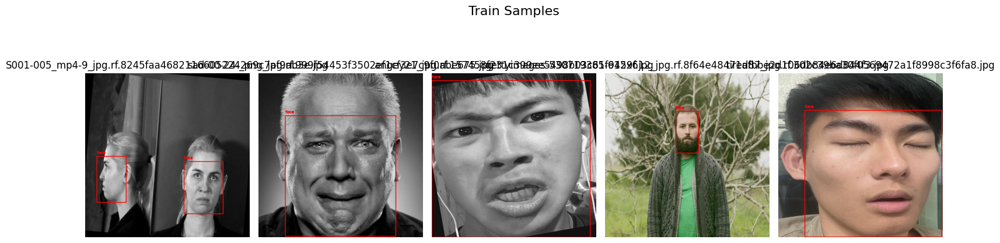

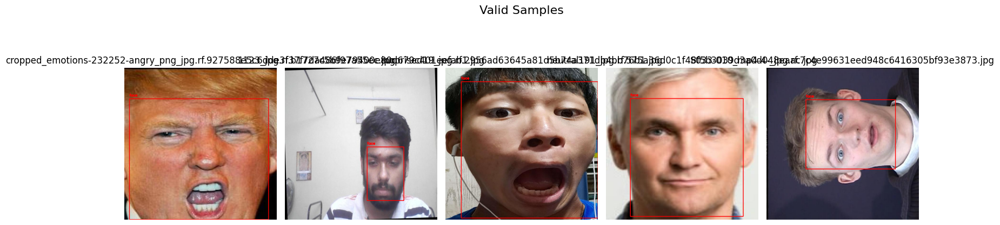

In [ ]:
# Visualize Sample Images
def visualize_samples(dataset_root, num_samples=3):
    """
    Visualizes sample images with annotations

    Args:
        dataset_root: Root directory of the dataset
        num_samples: Number of samples to display from each set
    """
    sets = ['train', 'valid']

    #Construct paths to images and labels directories
    for set_name in sets:
        image_dir = os.path.join(dataset_root, set_name, 'images')
        label_dir = os.path.join(dataset_root, set_name, 'labels')

        if not os.path.exists(image_dir) or not os.path.exists(label_dir):
            continue
        # Get list of image files (supports .png, .jpg, .jpeg)
        image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        if not image_files:
            continue

        ## Create figure for displaying samples
        plt.figure(figsize=(15, 5))
        plt.suptitle(f'{set_name.capitalize()} Samples', fontsize=16)

        # Select random image file
        for i in range(min(num_samples, len(image_files))):
            img_file = random.choice(image_files)
            img_path = os.path.join(image_dir, img_file)
            label_path = os.path.join(label_dir, os.path.splitext(img_file)[0] + '.txt')   # Corresponding label file path (same name but .txt extension)

            # Read image
            img = cv2.imread(img_path)
            if img is None:
                continue
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for matplotlib display

            # Read and draw annotations if they exist
            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    lines = f.readlines()

                # Get image dimensions for coordinate conversion
                h, w = img.shape[:2]
                for line in lines:
                    parts = line.strip().split()
                    if len(parts) >= 5:
                        class_id, x_center, y_center, width, height = map(float, parts[:5])

                        # Convert YOLO format to pixel coordinates
                        x_center *= w
                        y_center *= h
                        width *= w
                        height *= h

                        # Calculate box coordinates
                        x1 = int(x_center - width/2)
                        y1 = int(y_center - height/2)
                        x2 = int(x_center + width/2)
                        y2 = int(y_center + height/2)

                        # Draw rectangle and label
                        cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)
                        cv2.putText(img, 'face', (x1, y1-10),
                                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

            # Display image
            plt.subplot(1, num_samples, i+1)
            plt.imshow(img)
            plt.axis('off')
            plt.title(os.path.basename(img_file))

        plt.tight_layout()
        plt.show()

visualize_samples("/content/dataset", num_samples=5)


This code initializes and loads a pre-trained YOLO (You Only Look Once) object detection model for making predictions or further training.

## 🚀 What is YOLO11?

YOLO11 is the newest version of the popular Ultralytics YOLO (You Only Look Once) series of real-time object detection models. It takes the strengths of previous versions and pushes them even further with better accuracy, faster performance, and more efficient processing. With improvements in its design and training techniques, YOLO11 can handle a variety of computer vision tasks, making it a flexible and powerful tool for developers and researchers alike.

 📦 **Model Sizes for Every Need**

YOLO11 provides **5 scalable model sizes**, helping you balance speed, accuracy, and resource consumption:

| Model | Description |
|-------|-------------|
| `n` (Nano) | 🪶 Ultra-lightweight, perfect for edge/IoT devices |
| `s` (Small) | ⚡ Fast inference with moderate accuracy |
| `m` (Medium) | ⚖️ Balanced speed and precision |
| `l` (Large) | 🧠 High-accuracy tasks |
| `x` (Extra-large) | 🔍 Maximum accuracy, ideal for powerful hardware |

---

YOLO11 is designed to handle a wide range of computer vision tasks with high efficiency and accuracy. The supported tasks include:

**Object Detection**: Detects and locates objects within an image.

**Instance Segmentation**: Identify and segment individual objects in an image.

**Image Classification**: Assign a label to the entire image based on its content.

**Pose/Keypoints Estimation**: Detect key points of interest in humans or objects to estimate pose.

**Oriented Object Detection**: Detect objects with orientation angles (e.g., rotated bounding boxes).

**Multi-Object Tracking**: Available for Detect, Segment, and Pose models, enabling real-time tracking of objects across frames.

**YOLO11m** it achieves a higher mean Average Precision (mAP) on the COCO (Common Objects in Context) dataset.
Despite the improved accuracy, it uses 22% fewer parameters compared to YOLOv8m, making it lightweight and efficient. source(https://pyimagesearch.com/2025/01/13/getting-started-with-yolo11/)

In [ ]:
import torch
from ultralytics import YOLO

# Load the pre-trained model
model = YOLO("yolo11m.pt")

100%|██████████| 38.8M/38.8M [00:00<00:00, 305MB/s]


In [ ]:
# Verify model architecture
model.info()

YOLO11m summary: 231 layers, 20,114,688 parameters, 0 gradients, 68.5 GFLOPs


(231, 20114688, 0, 68.52838399999999)

**🧠 Key Metrics Breakdown:**

Layers:	231	Total neural network layers in the architecture

Parameters:	20,114,688 (~20.1M)	Trainable weights in the model

Gradients:	0	Indicates model is in inference mode (not training)

GFLOPs:	68.5	Floating point operations required for one forward pass (in billions)


Let's perform comprehensive validation of the YOLO model on the specified dataset, calculating key object detection metrics and generating visual results.

In [ ]:
#model evaluation
metrics = model.val(data="/content/dataset/data.yaml")

Ultralytics 8.3.137 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,091,712 parameters, 0 gradients, 68.0 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 158MB/s]

val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 68.0±111.7 MB/s, size: 37.1 KB)



val: Scanning /content/dataset/valid/labels... 854 images, 0 backgrounds, 0 corrupt: 100%|██████████| 854/854 [00:00<00:00, 983.67it/s]

val: New cache created: /content/dataset/valid/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.14it/s]


                   all        854        924      0.347     0.0568    0.00663    0.00213
                person        165        217     0.0848      0.341      0.039     0.0127
               bicycle        100        100          0          0          0          0
                   car         80         80          0          0   0.000737   0.000147
            motorcycle        163        180          0          0          0          0
              airplane        155        156          1          0          0          0
                   bus        191        191          1          0          0          0
Speed: 0.5ms preprocess, 23.3ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val


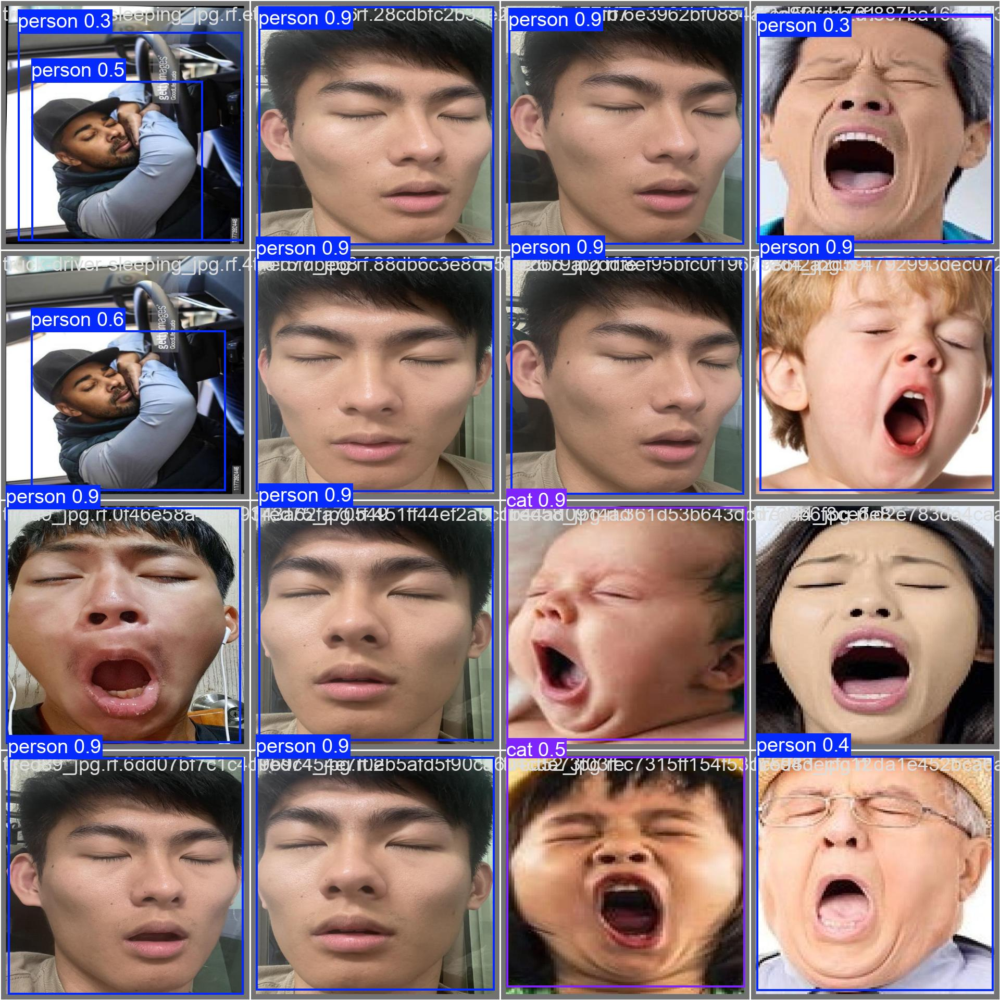

In [ ]:
# Shows model predictions
from IPython.display import Image as IPyImage

IPyImage(filename=f'/content/{str(metrics.save_dir)}/val_batch0_pred.jpg', width=1000)

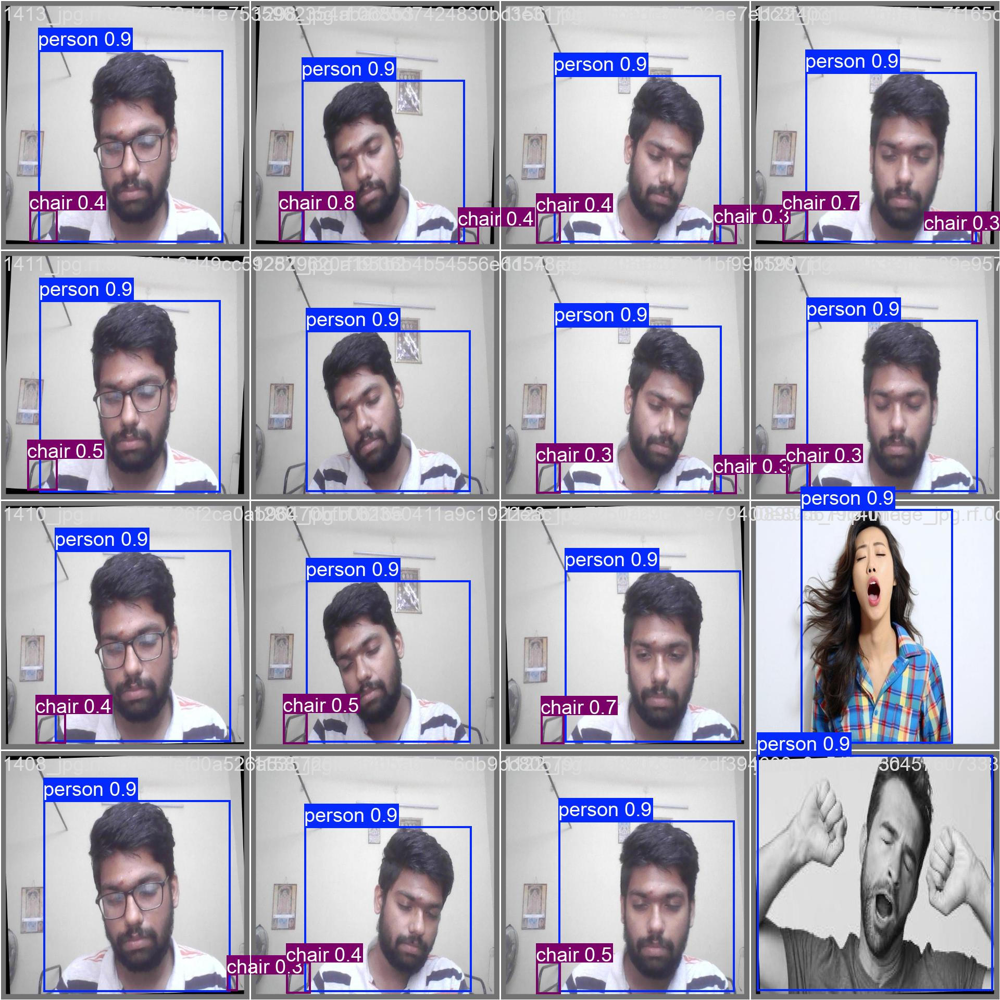

In [ ]:
IPyImage(filename=f'/content/{str(metrics.save_dir)}/val_batch1_pred.jpg', width=1000)

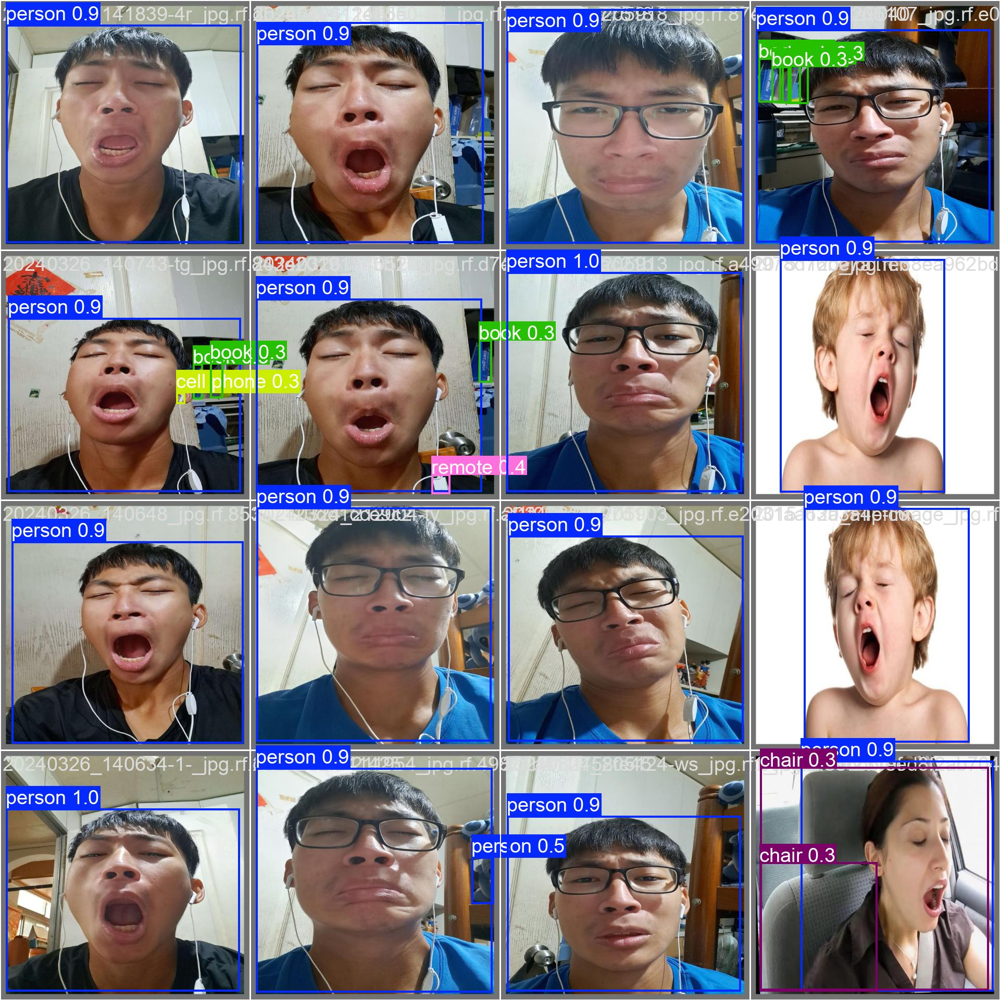

In [ ]:
IPyImage(filename=f'/content/{str(metrics.save_dir)}/val_batch2_pred.jpg', width=1000)

After we saw the output from the pre-trained yolo11 model

**🎯 Let's start the model training**

In [ ]:
# Training parameters
epochs = 100               # Total training cycles
batch_size = 16            # Images processed simultaneously
imgsz = 640                # Input image size (pixels)
patience = 10              # early stopping threshold
device = 0                 # GPU device

In [ ]:
# Start training
results = model.train(
    data='/content/dataset/data.yaml',
    epochs=epochs,
    batch=batch_size,
    imgsz=imgsz,
    patience=patience,
    device=device,
    optimizer='auto',)

Ultralytics 8.3.137 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=10, perspective=0.0, plots=True, pose=12.0, pretrained=True

100%|██████████| 5.35M/5.35M [00:00<00:00, 339MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 17.9±7.0 MB/s, size: 39.7 KB)


train: Scanning /content/dataset/train/labels... 5895 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5895/5895 [00:06<00:00, 917.60it/s]

train: New cache created: /content/dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.9±1.9 ms, read: 740.3±220.9 MB/s, size: 37.5 KB)


val: Scanning /content/dataset/valid/labels.cache... 854 images, 0 backgrounds, 0 corrupt: 100%|██████████| 854/854 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      8.06G      1.459      2.382      1.944         14        640: 100%|██████████| 369/369 [03:33<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.06it/s]

                   all        854        924       0.55      0.587      0.607      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      8.21G      1.071      1.331      1.526         15        640: 100%|██████████| 369/369 [03:28<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.00it/s]

                   all        854        924      0.584      0.568      0.566      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      8.21G      1.019      1.152       1.47         18        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.09it/s]

                   all        854        924       0.66      0.659      0.771      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      8.23G     0.9836      1.061      1.427         26        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.13it/s]

                   all        854        924      0.667      0.723      0.762      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      8.23G     0.9523     0.9875      1.402         19        640: 100%|██████████| 369/369 [03:25<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.13it/s]

                   all        854        924      0.802      0.756      0.867      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      8.24G     0.9071     0.9298      1.368         18        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.14it/s]

                   all        854        924      0.793       0.77      0.879       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      8.17G     0.9069     0.8844      1.357         21        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.10it/s]

                   all        854        924      0.835      0.758      0.823      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      8.23G     0.8854     0.8317      1.343         17        640: 100%|██████████| 369/369 [03:27<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.14it/s]

                   all        854        924      0.834       0.76      0.855      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      8.23G     0.8748     0.8208      1.332         13        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.14it/s]

                   all        854        924      0.825      0.764      0.845      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      8.24G     0.8471     0.7726      1.311         24        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.13it/s]

                   all        854        924      0.832      0.788      0.915      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      8.17G     0.8542     0.7629      1.315         18        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.12it/s]

                   all        854        924      0.769       0.73      0.816      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      8.22G     0.8351     0.7455      1.302         17        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.14it/s]

                   all        854        924      0.857      0.829      0.927      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      8.23G     0.8231     0.7212       1.29         15        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.13it/s]

                   all        854        924      0.855      0.861      0.936      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      8.23G     0.8162      0.707      1.285         22        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.15it/s]

                   all        854        924      0.874      0.785       0.88      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      8.17G     0.8091      0.683      1.283         19        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.14it/s]

                   all        854        924      0.851       0.82      0.896      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      8.22G     0.8003      0.679      1.275         18        640: 100%|██████████| 369/369 [03:25<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.07it/s]

                   all        854        924      0.852      0.827      0.873      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      8.23G     0.7921     0.6748      1.271         17        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.13it/s]

                   all        854        924      0.793      0.891      0.918      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      8.24G     0.7837     0.6419      1.259         12        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.13it/s]

                   all        854        924      0.889      0.778        0.9       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      8.16G     0.7761     0.6336      1.256         20        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.04it/s]

                   all        854        924       0.86      0.816      0.874      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      8.23G     0.7849     0.6294      1.269         16        640: 100%|██████████| 369/369 [03:27<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.12it/s]

                   all        854        924      0.839      0.798      0.858      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      8.24G     0.7668     0.6265      1.249         14        640: 100%|██████████| 369/369 [03:27<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.08it/s]

                   all        854        924      0.841      0.841      0.919      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      8.24G     0.7599     0.5984      1.244         17        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.07it/s]

                   all        854        924      0.858      0.822      0.899      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      8.17G     0.7622     0.6049      1.247         12        640: 100%|██████████| 369/369 [03:26<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:12<00:00,  2.13it/s]

                   all        854        924      0.862      0.795      0.899      0.694
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 13, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



23 epochs completed in 1.421 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 40.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.137 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,034,658 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:14<00:00,  1.90it/s]


                   all        854        924      0.854      0.861      0.936      0.706
                 angry        165        217      0.657      0.926      0.862      0.609
                 happy        100        100       0.94       0.97      0.986      0.779
               neutral         80         80      0.841      0.838      0.911      0.788
                   sad        163        180       0.83      0.922      0.952      0.656
             surprised        155        156      0.913      0.608      0.943      0.709
                 tired        191        191      0.945      0.899      0.965      0.696
Speed: 0.2ms preprocess, 10.7ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train


### Because of the early stopping threshould we got 23 epochs completed in 1.421 hours to train the model on our data.

Choice of optimizer for training. Options include SGD, Adam, AdamW, NAdam, RAdam, RMSProp etc., or auto for automatic selection based on model configuration. Affects convergence speed and stability. source(https://docs.ultralytics.com/usage/cfg/)

Let's download the trained model to upload it on the drive and use it in our next steps as after a while all the files are deleted from google colab.

In [ ]:
from google.colab import files

# Download the best model
files.download('/content/runs/detect/train/weights/best.pt')

# Download the last model
files.download('/content/runs/detect/train/weights/last.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

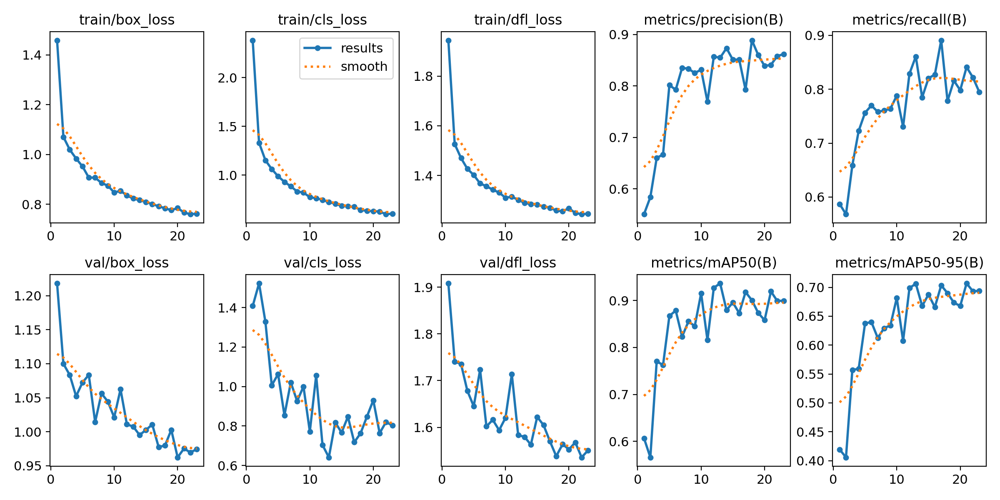

In [ ]:
# display the training metrics graph
IPyImage(filename='/content/runs/detect/train/results.png', width=1000)

This graph shows the learning over the 23 epochs

📈 **Training Metrics**

train/box_loss:  Represents the loss related to bounding box regression during training.
It steadily decreases, indicating the model is learning to localize objects better over time.

train/cls_loss: This is the classification loss on the training set.
Also shows a consistent decrease, meaning the model is getting better at classifying objects.

train/dfl_loss: DFL usually refers to "Distribution Focal Loss", used for more accurate bounding box regression.
It too decreases, suggesting improvement in localization precision.

metrics/precision: Precision on the training set.
Increasing trend, generally above 0.85 after ~10 epochs, which means fewer false positives over time. High precision = Few false positives

metrics/recall: Recall on the training set.
This shows more fluctuation than precision but trends upwards, indicating improving ability to detect all relevant objects. High recall = Few false negatives (missed objects)


📈 **Validation Metrics**

val/box_loss:Box regression loss on the validation set.

Decreasing trend, though more noisy than training loss (expected), suggesting generalization is improving.

val/cls_loss:
Classification loss on the validation set.
Similar decreasing pattern with more variability—still an encouraging sign.

val/dfl_loss:
Validation distribution focal loss.
Shows a drop over epochs, with some fluctuations, implying improvement in prediction quality.

metrics/mAP50:
Mean Average Precision at IoU threshold 0.5.
This is steadily increasing, reaching close to 0.9, indicating strong detection accuracy.

metrics/mAP50-95:
Mean Average Precision averaged over IoU thresholds from 0.5 to 0.95.
Starts lower (~0.4) and increases toward 0.7, reflecting improving overall object detection performance across stricter localization thresholds.



✅ **Conclusion**

- Losses (train/val) are decreasing → model is learning.

- Metrics (precision, recall, mAP) are increasing → performance is improving.

- Some fluctuations in recall and val losses are expected and normal.

- The model appears to be training effectively with no major signs of overfitting or underfitting as of the last epoch.

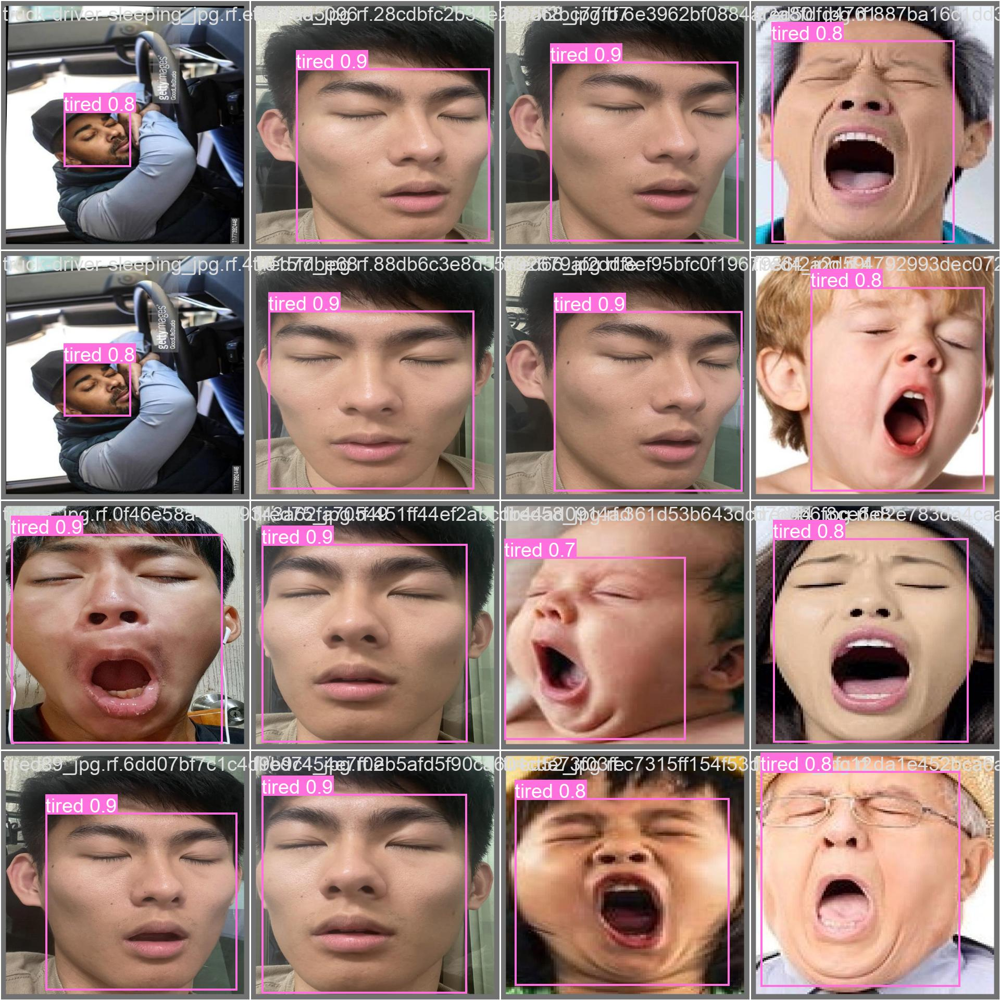

In [ ]:
IPyImage(filename='/content/runs/detect/train/val_batch0_pred.jpg', width=1000)

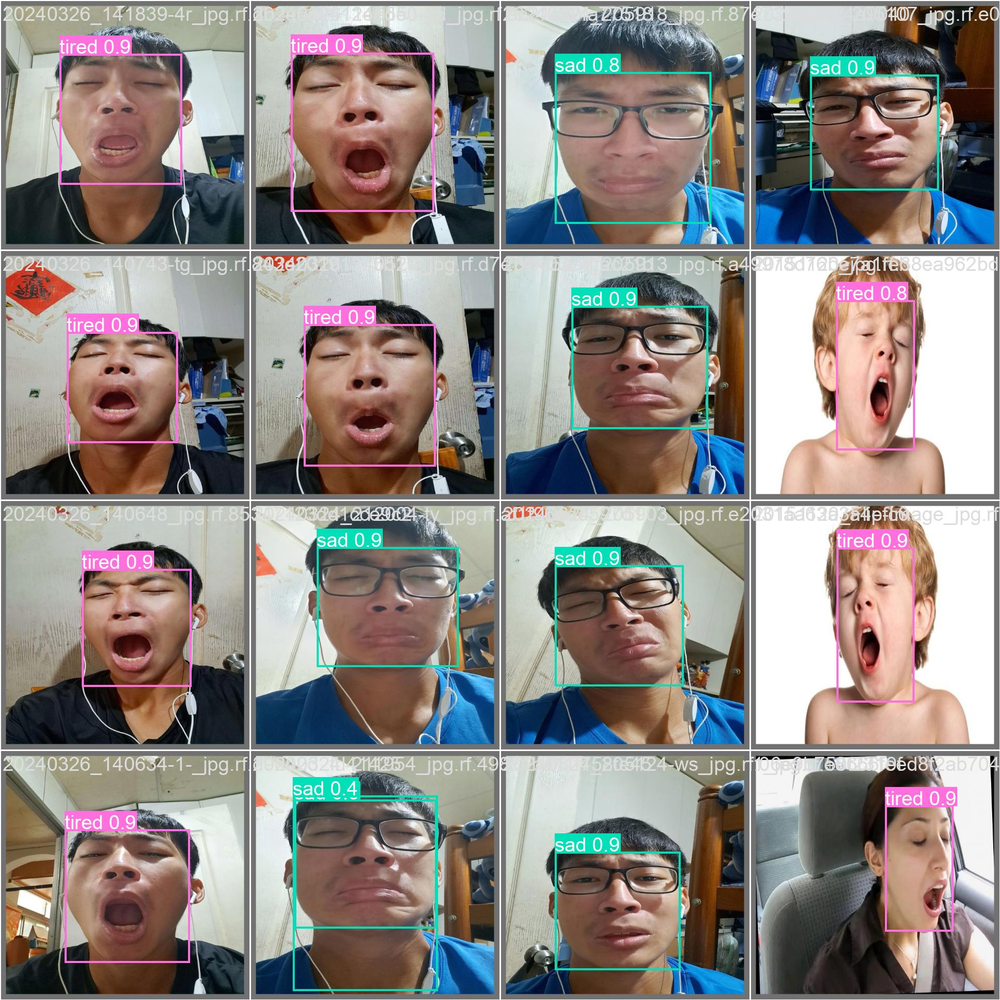

In [ ]:
IPyImage(filename='/content/runs/detect/train/val_batch1_pred.jpg', width=1000)

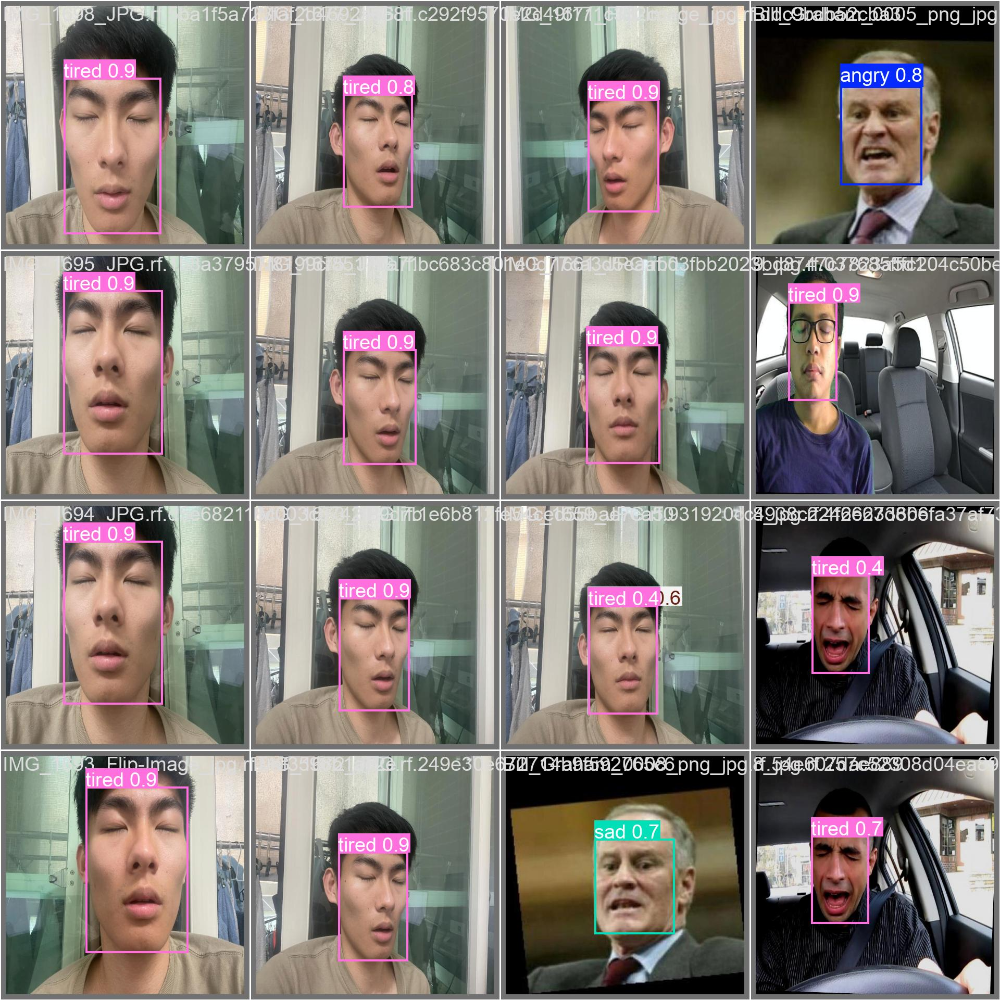

In [ ]:
IPyImage(filename='/content/runs/detect/train/val_batch2_pred.jpg', width=1000)

Loads our best-performing model weights from training

In [ ]:
from ultralytics import YOLO

our_custom_model: YOLO = YOLO("/content/runs/detect/train/weights/best.pt")

**Test our trained yolo model on an image from the internet to detect faces and emotions**

100%|██████████| 47.6k/47.6k [00:00<00:00, 43.7MB/s]

image 1/1 /content/young-couple.jpg: 640x640 2 happys, 36.1ms
Speed: 3.6ms preprocess, 36.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


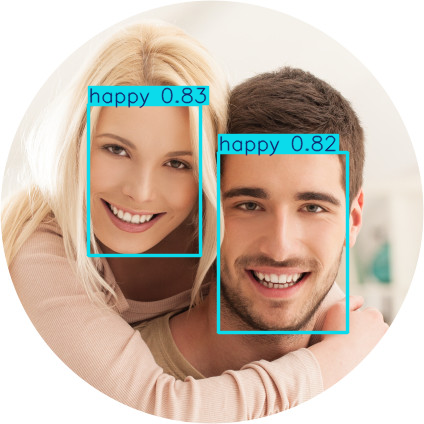

In [ ]:
our_custom_model.predict("https://res.cloudinary.com/demo/image/upload/w_0.5,ar_1,c_thumb,g_faces,z_0.7/r_max/docs/young-couple.jpg")[0].show()

**Another test**

100%|██████████| 962k/962k [00:00<00:00, 31.9MB/s]

image 1/1 /content/Variety_of_male_human_faces_(collage).jpg: 640x640 2 happys, 2 neutrals, 1 surprised, 36.2ms
Speed: 4.0ms preprocess, 36.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


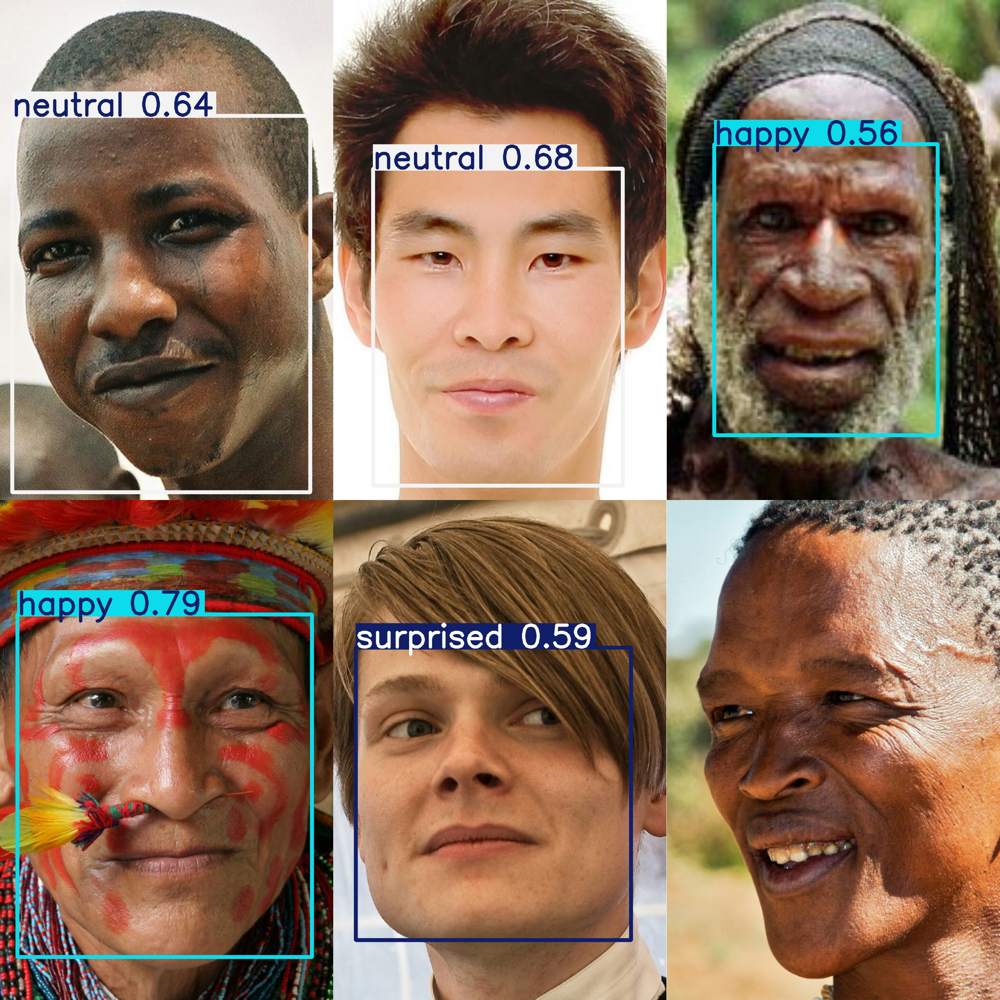

In [ ]:
our_custom_model.predict("https://upload.wikimedia.org/wikipedia/commons/6/67/Variety_of_male_human_faces_%28collage%29.jpg")[0].show()

**After finishing the training of the model we uploaded it on the drive as the files on colab are deleted after a while and we are going to use the normal CPU from here instead of the GPU because of the resource management.**

In [ ]:
!pip install deepface opencv-python-headless ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 4.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.6/108.6 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 24.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 52.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 73.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 78.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.9 MB/s eta 0:00:00
   ━━━━━━

In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np
from deepface import DeepFace
import matplotlib.pyplot as plt
import gdown
import os

# Download the model from Google Drive
def download_model(file_url, output_path):
    gdown.download(file_url, output_path, quiet=False)

# Google Drive file ID and model path
file_id = '1aADfGzx52KAsa0zr-wnMNGFgTD0x4v3N'
model_filename = 'yolov11_face_emotion.pt'
model_path = f'/content/{model_filename}'

# Download the model
if not os.path.exists(model_path):
    file_url = f'https://drive.google.com/uc?id={file_id}'
    download_model(file_url, model_path)

# Load your custom YOLOv11 model
yolo_model = YOLO(model_path)
print("Model loaded successfully!")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
25-05-18 13:47:39 - Directory /root/.deepface has been created
25-05-18 13:47:39 - Directory /root/.deepface/weights has been created


Downloading...
From (original): https://drive.google.com/uc?id=1aADfGzx52KAsa0zr-wnMNGFgTD0x4v3N
From (redirected): https://drive.google.com/uc?id=1aADfGzx52KAsa0zr-wnMNGFgTD0x4v3N&confirm=t&uuid=a2fcc7d8-93a7-4661-8102-78a277c3f0e7
To: /content/yolov11_face_emotion.pt
100%|██████████| 40.5M/40.5M [00:00<00:00, 76.3MB/s]


Model loaded successfully!


In [ ]:
file_id = "19MDAsbtnt5sgM-2AfTMcWsbRJsaNpfV9"
output_path = "test1_image.jpg"
gdown.download(f"https://drive.google.com/uc?id={file_id}", output_path)

Downloading...
From: https://drive.google.com/uc?id=19MDAsbtnt5sgM-2AfTMcWsbRJsaNpfV9
To: /content/test1_image.jpg
100%|██████████| 48.8k/48.8k [00:00<00:00, 50.7MB/s]


'test1_image.jpg'

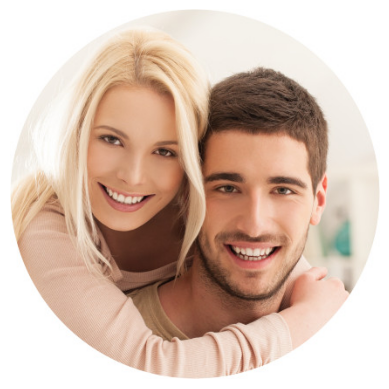

In [ ]:
img = cv2.imread(output_path)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

As you can see we are going to test the pipleline we will build in the next function on this image to do the prediction from yolo and deepface

**What is DeepFace?**

DeepFace AI is the most lightweight face recognition and facial attribute analysis library for Python.

can do facial attribute analysis refers to describing the visual properties of face images. Accordingly, facial attributes analysis is used to extract attributes such as age, gender classification, emotion analysis, or race/ethnicity prediction.

source(https://viso.ai/computer-vision/deepface/)

## 🖼️ Working with Images

Let's build **process_image** function

That detects faces in an image, analyzes each face's age/gender/emotion, and annotates the results

In [ ]:
def process_image(img_path, output_path=None):

    # Read image
    img = cv2.imread(img_path)
    if img is None:
        print(f"Error: Could not read image {img_path}")
        return

    # Run YOLO detection
    results = yolo_model(img)   # returns bounding boxes, confidences, and class IDs

    # Process each detected face
    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confidences = result.boxes.conf.cpu().numpy()
        class_ids = result.boxes.cls.cpu().numpy()

        for box, conf, cls_id in zip(boxes, confidences, class_ids):
            x1, y1, x2, y2 = map(int, box)
            face_img = img[y1:y2, x1:x2]

            # Skip if face region is too small
            if face_img.size == 0:
                continue

            emotion = yolo_model.names[int(cls_id)] if hasattr(yolo_model, 'names') else 'Face'

            # Face analysis
            try:
                demography = DeepFace.analyze(
                    face_img,
                    actions=['age', 'gender', 'emotion'], #, 'race'
                    enforce_detection=False,
                    detector_backend='opencv',
                    silent=True

                )
                print("DeepFace analysis successful:", demography)


                if isinstance(demography, list):
                    demography = demography[0]

                age = int(demography['age'])
                gender = demography['gender']
                dominant_gender = max(gender.items(), key=lambda x: x[1])[0]
                emotion = max(demography['emotion'].items(), key=lambda x: x[1])[0]
                #race = max(demography['race'].items(), key=lambda x: x[1])[0]

            except Exception as e:
                print(f"Face analysis failed: {e}")
                continue

            # Draw results
            label = f"{emotion}, {dominant_gender}, {age}"  #, {race}
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(img, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)

    # Output results
    if output_path:
        cv2.imwrite(output_path, img)
    else:
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()



by testing it we got:


0: 640x640 2 happys, 1377.1ms
Speed: 4.7ms preprocess, 1377.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
DeepFace analysis successful: [{'age': 33, 'region': {'x': 0, 'y': 0, 'w': 111, 'h': 147, 'left_eye': (87, 61), 'right_eye': (26, 46)}, 'face_confidence': np.float64(0.96), 'gender': {'Woman': np.float32(99.98682), 'Man': np.float32(0.01318173)}, 'dominant_gender': 'Woman', 'emotion': {'angry': np.float32(1.5881061e-07), 'disgust': np.float32(3.3539848e-13), 'fear': np.float32(1.1873152e-10), 'happy': np.float32(99.99479), 'sad': np.float32(1.7728796e-08), 'surprise': np.float32(8.952594e-06), 'neutral': np.float32(0.005204375)}, 'dominant_emotion': 'happy'}]
DeepFace analysis successful: [{'age': 28, 'region': {'x': 0, 'y': 0, 'w': 128, 'h': 172, 'left_eye': (90, 55), 'right_eye': (31, 54)}, 'face_confidence': np.float64(0.92), 'gender': {'Woman': np.float32(0.010702453), 'Man': np.float32(99.989296)}, 'dominant_gender': 'Man', 'emotion': {'angry': np.float

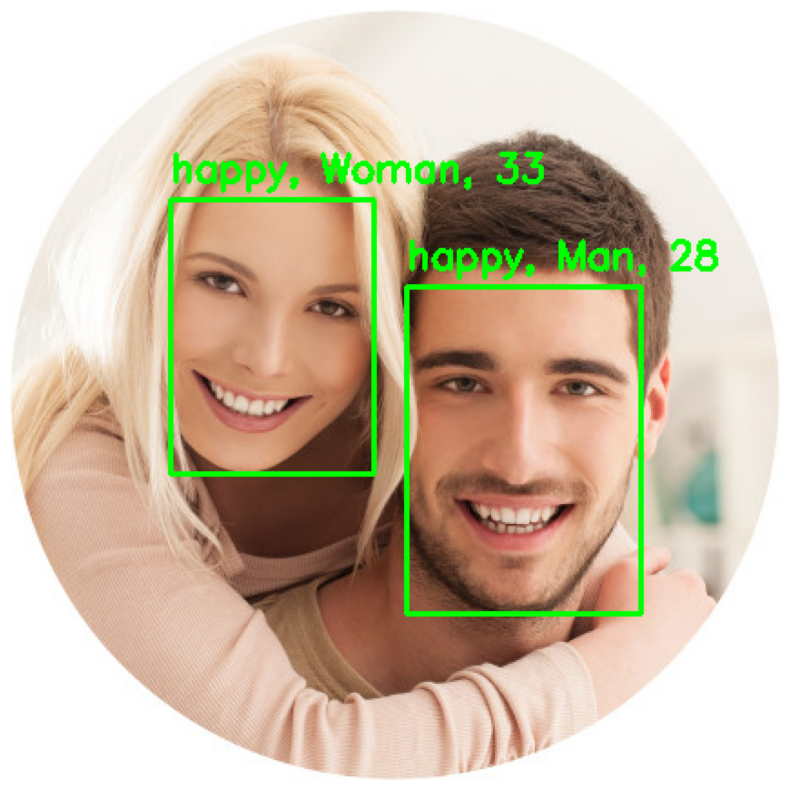

In [ ]:
# Use direct download link format
image_url = output_path
process_image(image_url)

In [ ]:
file_id = "1loAHo5e8r0XFCmyFP8tynSfxX6hjlINF"
output_path2 = "test2_image.jpg"
gdown.download(f"https://drive.google.com/uc?id={file_id}", output_path2)

Downloading...
From: https://drive.google.com/uc?id=1loAHo5e8r0XFCmyFP8tynSfxX6hjlINF
To: /content/test2_image.jpg
100%|██████████| 178k/178k [00:00<00:00, 42.1MB/s]


'test2_image.jpg'


0: 640x384 1 surprised, 872.7ms
Speed: 4.2ms preprocess, 872.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)
DeepFace analysis successful: [{'age': 31, 'region': {'x': 0, 'y': 0, 'w': 390, 'h': 463, 'left_eye': (307, 145), 'right_eye': (115, 121)}, 'face_confidence': np.float64(0.96), 'gender': {'Woman': np.float32(99.936966), 'Man': np.float32(0.0630281)}, 'dominant_gender': 'Woman', 'emotion': {'angry': np.float32(11.157979), 'disgust': np.float32(1.24068165e-05), 'fear': np.float32(2.0294206), 'happy': np.float32(0.025933007), 'sad': np.float32(26.796103), 'surprise': np.float32(0.026760394), 'neutral': np.float32(59.9638)}, 'dominant_emotion': 'neutral'}]


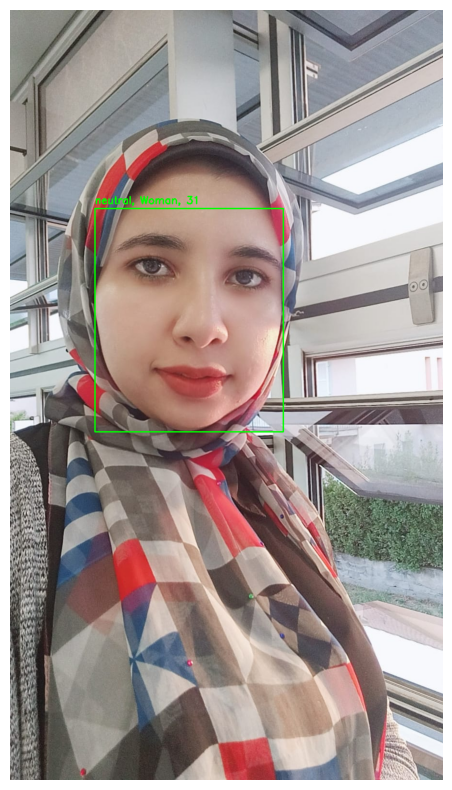

In [ ]:
image_url = output_path2
process_image(image_url)

## NOW!! Let's play with videos 🎥

Video Processing Function: **process_video**

Processes video frames to:

- Detect faces using YOLOv11

- Analyze age/gender for each face using DeepFace

- Annotate frames with bounding boxes and attributes

- Output processed video or display previews

and it allows to:

Frame Selection: Skips frames to improve processing speed

Multi-Analysis: Combines YOLO detection + DeepFace attributes

Flexible Output: Saves video or displays preview frames


In [ ]:
!pip install supervision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 3.7 MB/s eta 0:00:00


Download the videos to test on them

In [ ]:
file_id = "1SIcgP-uywqvvCRiTrfgXgvXQTrN6-Hy6"
video_path = "test_video.mp4v"
gdown.download(f"https://drive.google.com/uc?id={file_id}", video_path)

Downloading...
From: https://drive.google.com/uc?id=1SIcgP-uywqvvCRiTrfgXgvXQTrN6-Hy6
To: /content/test_video.mp4v
100%|██████████| 16.5M/16.5M [00:00<00:00, 61.4MB/s]


'test_video.mp4v'

In [ ]:
file_id = "1UIKYayRrxx8epELbFvbLorJsP2_H3dhS"
video_path2 = "test2_video.mp4v"
gdown.download(f"https://drive.google.com/uc?id={file_id}", video_path2)

Downloading...
From: https://drive.google.com/uc?id=1UIKYayRrxx8epELbFvbLorJsP2_H3dhS
To: /content/test2_video.mp4v
100%|██████████| 9.92M/9.92M [00:00<00:00, 38.6MB/s]


'test2_video.mp4v'

you can get the videos from here:

1st video: https://drive.google.com/file/d/1UIKYayRrxx8epELbFvbLorJsP2_H3dhS/view?usp=drive_link

2nd video: https://drive.google.com/file/d/1SIcgP-uywqvvCRiTrfgXgvXQTrN6-Hy6/view?usp=drive_link

In [ ]:
def process_video(video_path, output_path=None, frame_skip=1, display_frames=False):

    # Open video file
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print(f"Error: Could not open video {video_path}")
        return

    # Get video properties
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Initialize video writer (use XVID for Colab compatibility)
    if output_path:
        fourcc = cv2.VideoWriter_fourcc(*'XVID')  # Works better in Colab than 'mp4v'
        out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

    frame_count = 0
    processed_count = 0

    print(f"Processing video: {video_path}")
    print(f"Resolution: {frame_width}x{frame_height}, FPS: {fps:.1f}, Total frames: {total_frames}")
    print(f"Processing every {frame_skip} frame(s)...")

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        frame_count += 1

        # Skip frames if frame_skip > 1
        if frame_count % frame_skip != 0:
            continue

        processed_count += 1

        # Run YOLO detection
        results = yolo_model(frame)

        # Process each detected face
        for result in results:
            boxes = result.boxes.xyxy.cpu().numpy()
            confidences = result.boxes.conf.cpu().numpy()
            class_ids = result.boxes.cls.cpu().numpy()

            for box, conf, cls_id in zip(boxes, confidences, class_ids):
                x1, y1, x2, y2 = map(int, box)
                face_img = frame[y1:y2, x1:x2]

                # Skip if face region is too small
                if face_img.size == 0:
                    continue

                # Get emotion from YOLO
                emotion = yolo_model.names[int(cls_id)] if hasattr(yolo_model, 'names') else 'Face'

                # Run DeepFace for age, gender, and race
                try:
                    demography = DeepFace.analyze(
                        face_img,
                        actions=['age', 'gender'],  # , 'race'
                        enforce_detection=False,
                        detector_backend='opencv',
                        silent=True
                    )
                    if isinstance(demography, list):
                        demography = demography[0]

                    age = int(demography['age'])
                    gender = demography['gender']
                    dominant_gender = max(gender.items(), key=lambda x: x[1])[0]
                    #race = max(demography['race'].items(), key=lambda x: x[1])[0]  # Get dominant race

                except Exception as e:
                    print(f"DeepFace error: {e}")
                    age = "N/A"
                    dominant_gender = "N/A"
                    #race = "N/A"

                # Draw bounding box and information
                label = f"{emotion}, {dominant_gender}, {age}"  # , {race}
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(frame, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)

        # Write frame to output video
        if output_path:
            out.write(frame)

        # Display progress in Colab
        if display_frames and processed_count % 10 == 0:
            display_frame = cv2.resize(frame, (640, int(640 * frame_height/frame_width)))
            plt.figure(figsize=(10, 6))
            plt.imshow(cv2.cvtColor(display_frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Frame {frame_count}/{total_frames}")
            plt.axis('off')
            plt.show()

    # Release resources
    cap.release()
    if output_path:
        out.release()
        print(f"\nProcessed video saved to: {output_path}")

    print(f"\nProcessing complete!")
    print(f"Total frames: {total_frames}")
    print(f"Frames processed: {processed_count}")
    print(f"Frames skipped: {total_frames - processed_count}")

In [ ]:
process_video(video_path, "output1_v.mp4", frame_skip=10)   # 48 min process

In [ ]:
process_video(video_path2, "output2_v.mp4", frame_skip=5)   # 65 min process

Processing video: test2_video.mp4v
Resolution: 1280x720, FPS: 30.0, Total frames: 5757
Processing every 5 frame(s)...

0: 384x640 (no detections), 874.5ms
Speed: 2.9ms preprocess, 874.5ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 859.1ms
Speed: 3.1ms preprocess, 859.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 851.1ms
Speed: 3.8ms preprocess, 851.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 855.2ms
Speed: 3.0ms preprocess, 855.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 1040.6ms
Speed: 3.1ms preprocess, 1040.6ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 1327.8ms
Speed: 3.0ms preprocess, 1327.8ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 1214.0ms
Speed: 2.9ms preprocess, 1214.

###As it tooks long time to process the videos even by skipping many frames you can directly watch the output from the original videos after processing them from those links:

https://drive.google.com/file/d/1IIP9CoglA_QxpNFl1NGb40E4nI5PdZGs/view?usp=drive_link

https://drive.google.com/file/d/1Qmq8ltWJzGwgeqqEwea1Du3z-p_MFCXc/view?usp=drive_link

## ⚡ What about trying with the webcam now!

Webcam Processing Function: **process_webcam**

Captures and analyzes webcam feed in a Colab notebook to:

Periodically capture frames (every 10 seconds) can be adjusted as we need

Detect faces using YOLOv11

Analyze age/gender/emotion for each face using DeepFace

Display annotated results

In [ ]:
import cv2
import numpy as np
from IPython.display import display, Javascript
import matplotlib.pyplot as plt
from deepface import DeepFace
from ultralytics import YOLO
import base64
from google.colab import output
import time

In [ ]:
def process_webcam():
    # JavaScript for periodic frame capture
    js = Javascript('''
    async function capture() {
        const video = document.createElement('video');
        video.width = 640;
        video.height = 480;

        const stream = await navigator.mediaDevices.getUserMedia({
            video: {
                width: { ideal: 640 },
                height: { ideal: 480 },
                frameRate: { ideal: 15 }
            }
        });

        video.srcObject = stream;
        await video.play();

        // Create status display
        const statusDiv = document.createElement('div');
        statusDiv.style.color = 'white';
        statusDiv.style.backgroundColor = 'black';
        statusDiv.style.padding = '10px';
        document.body.appendChild(statusDiv);

        // Process every 10 seconds
        const processInterval = () => {
            const canvas = document.createElement('canvas');
            canvas.width = 640;
            canvas.height = 480;
            const ctx = canvas.getContext('2d');
            ctx.drawImage(video, 0, 0, 640, 480);

            statusDiv.textContent = 'Last capture: ' + new Date().toLocaleTimeString();

            const img = canvas.toDataURL('image/jpeg', 0.8);
            try {
                google.colab.kernel.invokeFunction('notebook.process_frame', [img], {});
            } catch (e) {
                console.error('Processing error:', e);
            }

            setTimeout(processInterval, 10000); // 10 seconds interval
        };

        // Initial call
        setTimeout(processInterval, 10000);
    }
    ''')
    display(js)

    def process_frame(img_data):
        try:
            # Decode image
            img_bytes = base64.b64decode(img_data.split(',')[1])
            img_arr = np.frombuffer(img_bytes, np.uint8)
            frame = cv2.imdecode(img_arr, cv2.IMREAD_COLOR)

            # Run face detection
            results = yolo_model(frame, verbose=False)[0]
            boxes = results.boxes.xyxy.cpu().numpy()

            if len(boxes) > 0:
                # Process all detected faces
                for box in boxes:
                    x1, y1, x2, y2 = map(int, box)
                    face_img = frame[y1:y2, x1:x2]

                    if face_img.size > 0:
                        try:
                            # Full analysis (since we're doing it less frequently)
                            demography = DeepFace.analyze(
                                face_img,
                                actions=['age', 'gender', 'emotion'],
                                enforce_detection=False,
                                detector_backend='opencv',
                                silent=True
                            )[0]

                            age = int(demography['age'])
                            gender = max(demography['gender'].items(), key=lambda x: x[1])[0]
                            emotion = max(demography['emotion'].items(), key=lambda x: x[1])[0]
                            label = f"{emotion}, {gender}, {age}"

                            # Draw results
                            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                            cv2.putText(frame, label, (x1, y1-10),
                                      cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)

                        except Exception as e:
                            print(f"Analysis error: {e}")

            # Display processed frame
            plt.figure(figsize=(10, 6))
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.title(f"Processed at: {time.strftime('%H:%M:%S')}")
            plt.show()

        except Exception as e:
            print(f"Frame processing error: {e}")

    output.register_callback('notebook.process_frame', process_frame)
    display(Javascript('capture();'))

In [ ]:
process_webcam()